In [13]:
import pandas as pd
import numpy as np
import datetime
import json
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas
import plotly.offline as pyo
import plotly.express as px
import plotly.graph_objects as go
import warnings

In [14]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)
warnings.filterwarnings("ignore")

## Data Overview

In [15]:
melhouse = pd.read_csv('melb_data.csv')
melhouse.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,2.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,...,1.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0


In [16]:
melhouse.shape

(13580, 21)

In [17]:
melhouse.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13580 entries, 0 to 13579
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         13580 non-null  object 
 1   Address        13580 non-null  object 
 2   Rooms          13580 non-null  int64  
 3   Type           13580 non-null  object 
 4   Price          13580 non-null  float64
 5   Method         13580 non-null  object 
 6   SellerG        13580 non-null  object 
 7   Date           13580 non-null  object 
 8   Distance       13580 non-null  float64
 9   Postcode       13580 non-null  float64
 10  Bedroom2       13580 non-null  float64
 11  Bathroom       13580 non-null  float64
 12  Car            13518 non-null  float64
 13  Landsize       13580 non-null  float64
 14  BuildingArea   7130 non-null   float64
 15  YearBuilt      8205 non-null   float64
 16  CouncilArea    12211 non-null  object 
 17  Lattitude      13580 non-null  float64
 18  Longti

In [18]:
melhouse.isnull().sum()

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Distance            0
Postcode            0
Bedroom2            0
Bathroom            0
Car                62
Landsize            0
BuildingArea     6450
YearBuilt        5375
CouncilArea      1369
Lattitude           0
Longtitude          0
Regionname          0
Propertycount       0
dtype: int64

In [19]:
df_melhouse = melhouse.copy()

## Data Preprocession
### Drop off unnecessary columns
### This analysis focuses on the features affecting prices and tendency of prices. So we need to drop off some columns which is not necessary such as Address, Method, SellerG, Distance, postcode, CouncilArea, latti, longti, regionname, Propertycount

In [20]:
df_melhouse.drop(['Address','Method','SellerG','Distance','Postcode','CouncilArea','Lattitude','Longtitude','Regionname','Propertycount'],axis=1,inplace=True)

In [21]:
df_melhouse.shape

(13580, 11)

### Cross-Field Validation --Rooms should greater or equal to bedrooms.

In [22]:
# replace the Rooms no. as bedroom no. if room no. less than bedroom no.
df_melhouse.loc[df_melhouse['Rooms']<df_melhouse['Bedroom2'], 'Rooms'] = df_melhouse['Bedroom2']

### Deal with 'car' field, if car is Null, replace it to 1

In [23]:
df_melhouse['Car'].mean()

1.6100754549489569

In [24]:
df_melhouse.loc[df_melhouse['Car'].isnull(), 'Car'] = 1

In [25]:
df_melhouse.head()

,Suburb,Rooms,Type,Price,Date,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt
0,Abbotsford,2.0,h,1480000.0,3/12/2016,2.0,1.0,1.0,202.0,NaN,NaN
1,Abbotsford,2.0,h,1035000.0,4/02/2016,2.0,1.0,0.0,156.0,79.0,1900.0
2,Abbotsford,3.0,h,1465000.0,4/03/2017,3.0,2.0,0.0,134.0,150.0,1900.0
3,Abbotsford,3.0,h,850000.0,4/03/2017,3.0,2.0,1.0,94.0,NaN,NaN
4,Abbotsford,4.0,h,1600000.0,4/06/2016,3.0,1.0,2.0,120.0,142.0,2014.0


## Data Analysis

### Property Distrbution--Find which areas have the most properties for sale

In [26]:
property_count = df_melhouse[['Suburb','Type']]
property_count = property_count.groupby('Suburb').count().reset_index()

property_count.head()

,Suburb,Type
0,Abbotsford,56
1,Aberfeldie,44
2,Airport West,67
3,Albanvale,6
4,Albert Park,69


In [27]:
property_count = property_count.nlargest(20, 'Type')

In [28]:
property_count.head()

,Suburb,Type
236,Reservoir,359
237,Richmond,260
30,Bentleigh East,249
234,Preston,239
46,Brunswick,222


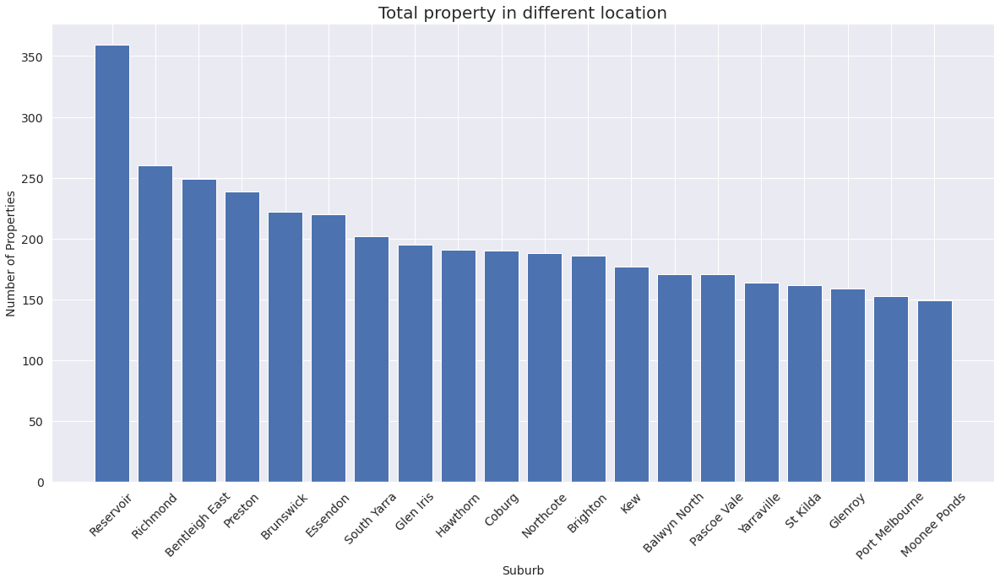

In [29]:
sns.set_theme(style="darkgrid")
plt.figure(figsize=(20,10))
plt.bar(property_count.Suburb,property_count.Type,color='b')
plt.title('Total property in different location', fontsize=20)
plt.xlabel('Suburb', fontsize=14)
plt.ylabel('Number of Properties', fontsize=14)
plt.tick_params(labelsize=14)
plt.xticks(rotation=45)
# for a,b in zip(count_by_location.index, count_by_location.values):
#     plt.text(a, b+5, b, fontsize=10, ha='center')
plt.show()

### Compare the average price in suburb by house, unit, townhouse

In [30]:
melhouse_house = df_melhouse.drop(df_melhouse[df_melhouse['Type']!='h'].index)
house = melhouse_house[['Suburb','Price']]
house_mean = house.groupby('Suburb')['Price'].agg(['mean']).apply(lambda x:x/1000000).round(2).reset_index()
house_mean = house_mean.sort_values(by = ['mean'])
house_mean_topk = house_mean.nlargest(20, 'mean')

melhouse_unit = df_melhouse.drop(melhouse[melhouse['Type']!='u'].index)
unit = melhouse_unit[['Suburb','Price']]
unit_mean = unit.groupby('Suburb')['Price'].agg(['mean']).apply(lambda x:x/1000000).round(2).reset_index()
unit_mean = unit_mean.sort_values(by = ['mean'])
unit_mean_topk = unit_mean.nlargest(20, 'mean')

melhouse_townhouse = df_melhouse.drop(melhouse[melhouse['Type']!='t'].index)
townhouse = melhouse_townhouse[['Suburb','Price']]
townhouse_mean = townhouse.groupby('Suburb')['Price'].agg(['mean']).apply(lambda x:x/1000000).round(2).reset_index()
townhouse_mean = townhouse_mean.sort_values(by = ['mean'])
townhouse_mean_topk = townhouse_mean.nlargest(20, 'mean')

<AxesSubplot:title={'center':'Townhouse Price in different location'}, xlabel='Suburb', ylabel='mean'>

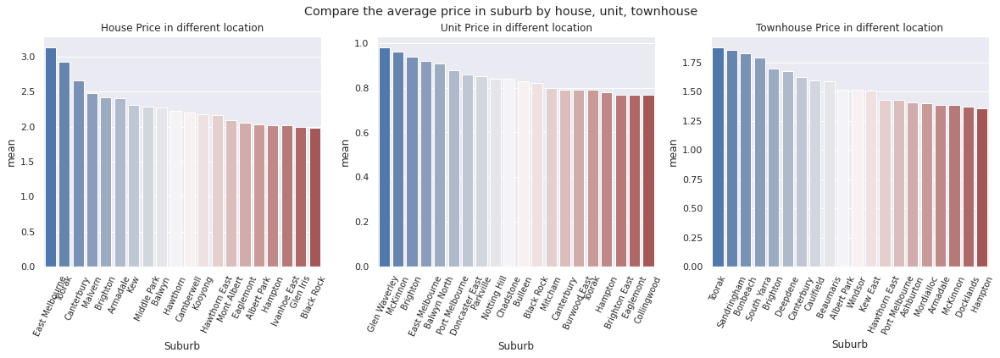

In [31]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))
fig.suptitle('Compare the average price in suburb by house, unit, townhouse')

ax0 = axs[0]
ax0.set_xticklabels(house_mean_topk['Suburb'],rotation = 65,fontsize = 'small')
ax0.set_title('House Price in different location')
ax0.get_yaxis().get_major_formatter().set_scientific(False)
ax1 = axs[1]
ax1.set_xticklabels(unit_mean_topk['Suburb'],rotation = 65,fontsize = 'small')
ax1.get_yaxis().get_major_formatter().set_scientific(False)
ax1.set_title('Unit Price in different location')
ax2 = axs[2]
ax2.set_xticklabels(townhouse_mean_topk['Suburb'],rotation = 65,fontsize = 'small')
ax2.get_yaxis().get_major_formatter().set_scientific(False)
ax2.set_title('Townhouse Price in different location')
     
sns.barplot(x="Suburb", y="mean", data=house_mean_topk, palette="vlag", ax = ax0)
sns.barplot(x="Suburb", y="mean", data=unit_mean_topk, palette="vlag", ax = ax1)
sns.barplot(x="Suburb", y="mean", data=townhouse_mean_topk, palette="vlag", ax = ax2)

### Use Heat Map to Analysis average price relate to Suburb, Rooms, Landsize

In [32]:
mel_region = geopandas.read_file("suburb-10-vic.geojson")

In [33]:
Property_map_summary = df_melhouse[['Suburb','Price','Type','Rooms','Landsize']].groupby(['Suburb','Type']).agg({'Price':'mean','Rooms':'mean','Landsize':'mean'})

In [34]:
# Set index colunm as uppercase to mach geojson column 'vic_loca_2'
Property_map_summary.index = Property_map_summary.index.set_levels(Property_map_summary.index.levels[0].str.upper(), level=0)

In [35]:
Property_map_summary.head()

Price     Rooms    Landsize
Suburb     Type                                    
ABBOTSFORD h     1.216662e+06  2.650000  187.100000
           t     1.212500e+06  3.500000   51.000000
           u     5.920714e+05  1.714286  627.928571
ABERFELDIE h     1.529531e+06  3.562500  562.156250
           t     1.117500e+06  3.000000  405.000000

In [36]:
# extract property type as house
h_df = Property_map_summary.loc[(slice(None),'h'),:].reset_index()
h_df.head()


,Suburb,Type,Price,Rooms,Landsize
0,ABBOTSFORD,h,1.216662e+06,2.650000,187.100000
1,ABERFELDIE,h,1.529531e+06,3.562500,562.156250
2,AIRPORT WEST,h,8.119091e+05,3.204545,554.113636
3,ALBANVALE,h,5.615000e+05,3.200000,557.800000
4,ALBERT PARK,h,2.032206e+06,2.793651,175.111111


In [37]:
h_df.drop('Type',axis=1,inplace=True)

In [38]:
# extract property type as unit
u_df = Property_map_summary.loc[(slice(None),'u'),:].reset_index()
u_df.drop('Type',axis=1,inplace=True)

In [39]:
# extract property type as townhouse
t_df = Property_map_summary.loc[(slice(None),'t'),:].reset_index()
t_df.drop('Type',axis=1,inplace=True)

In [40]:
def draw_plotmap_num(df,t):

    map= px.choropleth_mapbox(
                    data_frame=df,
                    geojson=mel_region,
                    color='Price',
                    locations='Suburb', 
                    featureidkey='properties.vic_loca_2',
                    mapbox_style="carto-positron",
                    color_continuous_scale='viridis',
                    center={"lat": -37.81110, "lon": 144.97150},
                    hover_data={'Suburb','Rooms','Landsize'},
                    opacity=0.7,
                    zoom=8,
                    title=t + ' -Average selling price in Melbourne',#map title
    )
   
    map.update_layout(margin=dict(
        l=0,
        r=0,
        b=50,
        t=30,
    ),height=600,width=900)
    
    map.show()

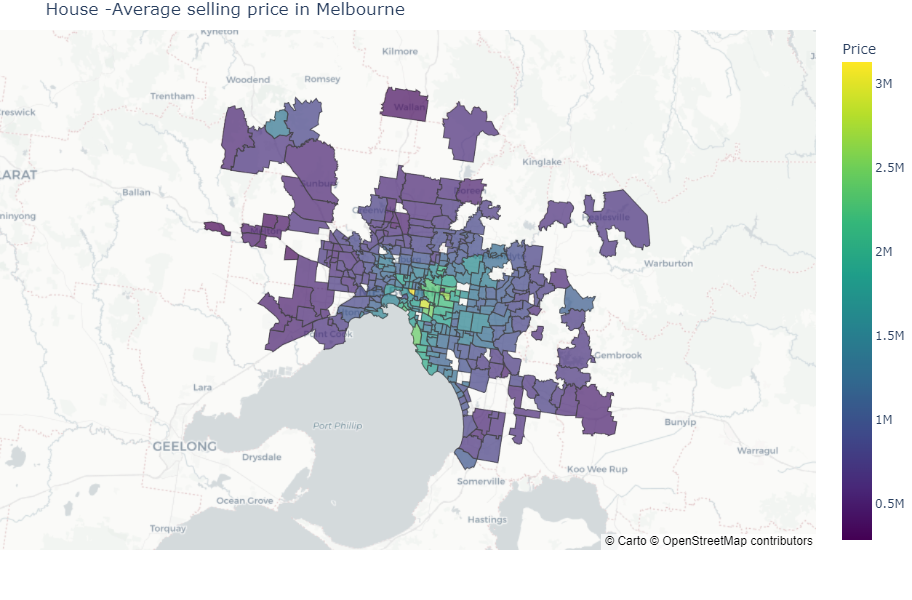

In [67]:
draw_plotmap_num(h_df,'House')
# draw_plotmap_num(u_df,'Unit')
# draw_plotmap_num(t_df,'Townhouse')

### Analysis Average Price trend by Time and compare with different types

In [42]:
date_price = df_melhouse[['Date','Price','Type']]
date_price[['Year','Month','Day']] = date_price['Date'].str.split('/', expand = True)[[2,1,0]]
date_price['Month_Year'] = date_price['Date'].str.split('/', n=1, expand = True)[1]
date_price = date_price.sort_values(by = ['Year','Month','Day'])
date_price.head()

,Date,Price,Type,Year,Month,Day,Month_Year
6183,28/01/2016,813000.0,u,2016,01,28,01/2016
6184,28/01/2016,1205000.0,h,2016,01,28,01/2016
1,4/02/2016,1035000.0,h,2016,02,4,02/2016
143,4/02/2016,720000.0,t,2016,02,4,02/2016
702,4/02/2016,1222500.0,h,2016,02,4,02/2016


In [43]:
# Get average price by time
date_price_mean = date_price[['Month_Year','Price','Type']].groupby(['Month_Year','Type']).agg({'Price':'mean'})

In [44]:
date_price_mean.head()

Price
Month_Year Type             
01/2016    h     1205000.000
           u      813000.000
02/2016    h     1054796.875
           t      808000.000
           u      539200.000

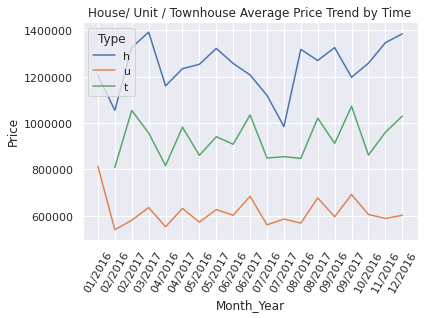

In [45]:
fig, ax = plt.subplots()
ax.get_yaxis().get_major_formatter().set_scientific(False)
sns.lineplot(data=date_price_mean, x="Month_Year", y="Price", hue="Type").set_title('House/ Unit / Townhouse Average Price Trend by Time')
for tick in ax.get_xticklabels():
    tick.set_rotation(60)

### View house/ unit/ townhouse price range for a specified time

In [46]:
data_price_h = date_price.loc[date_price['Type'].str.contains('h'), :]
data_price_u = date_price.loc[date_price['Type'].str.contains('u'), :]
data_price_t = date_price.loc[date_price['Type'].str.contains('t'), :]

In [47]:
data_price_h.head()

,Date,Price,Type,Year,Month,Day,Month_Year
6184,28/01/2016,1205000.0,h,2016,01,28,01/2016
1,4/02/2016,1035000.0,h,2016,02,4,02/2016
702,4/02/2016,1222500.0,h,2016,02,4,02/2016
1512,4/02/2016,1151000.0,h,2016,02,4,02/2016
1513,4/02/2016,1755000.0,h,2016,02,4,02/2016


<AxesSubplot:title={'center':'Townhouse Price Trend'}, xlabel='Month_Year', ylabel='Price'>

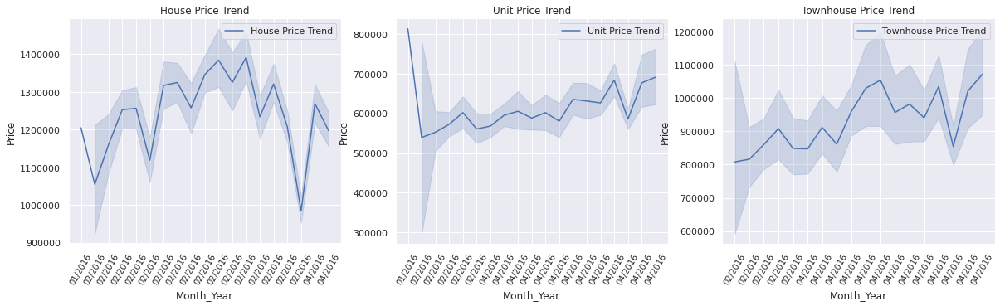

In [48]:
fig, axs = plt.subplots(nrows=1, ncols=3,figsize=(20, 5))
ax0 = axs[0]
ax0.set_xticklabels(data_price_h['Month_Year'],rotation = 60,fontsize = 'small')
ax0.set_title('House Price Trend')
ax0.get_yaxis().get_major_formatter().set_scientific(False)
ax1 = axs[1]
ax1.set_xticklabels(data_price_u['Month_Year'],rotation = 60,fontsize = 'small')
ax1.get_yaxis().get_major_formatter().set_scientific(False)
ax1.set_title('Unit Price Trend')
ax2 = axs[2]
ax2.set_xticklabels(data_price_t['Month_Year'],rotation = 60,fontsize = 'small')
ax2.get_yaxis().get_major_formatter().set_scientific(False)
ax2.set_title('Townhouse Price Trend')

sns.lineplot(x = data_price_h['Month_Year'],y = data_price_h['Price'], label = 'House Price Trend', ax = ax0)
sns.lineplot(x = data_price_u['Month_Year'],y = data_price_u['Price'], label = 'Unit Price Trend', ax = ax1)
sns.lineplot(x = data_price_t['Month_Year'],y = data_price_t['Price'], label = 'Townhouse Price Trend', ax = ax2)

### compare different type of property price by suburb

In [49]:
suburb_price = df_melhouse[['Suburb','Price','Type']]

In [50]:
suburb_price_h = suburb_price.loc[date_price['Type'].str.contains('h'), :]
suburb_price_u = suburb_price.loc[date_price['Type'].str.contains('u'), :]
suburb_price_t = suburb_price.loc[date_price['Type'].str.contains('t'), :]

In [51]:
# anaslys top k Suburb price, top k rely on the count of on sale property

suburb_price_h_top = property_count.merge(suburb_price_h,on='Suburb', how='left')
suburb_price_u_top = property_count.merge(suburb_price_u,on='Suburb', how='left')
suburb_price_t_top = property_count.merge(suburb_price_t,on='Suburb', how='left')
suburb_price_h_top.head()

,Suburb,Type_x,Price,Type_y
0,Reservoir,359,731000.0,h
1,Reservoir,359,723000.0,h
2,Reservoir,359,685000.0,h
3,Reservoir,359,620000.0,h
4,Reservoir,359,1025000.0,h


<AxesSubplot:title={'center':'Townhouse Price in different location'}, xlabel='Suburb', ylabel='Price'>

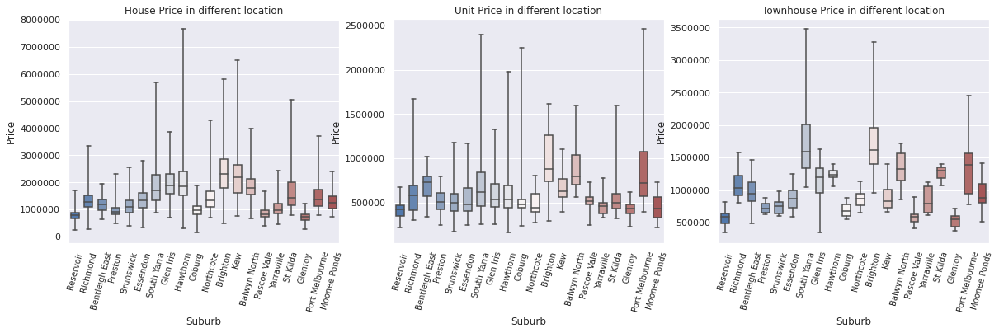

In [52]:
fig, axs = plt.subplots(nrows=1, ncols=3,figsize=(20, 5))
ax0 = axs[0]
ax0.set_xticklabels(suburb_price_h_top['Suburb'],rotation = 75,fontsize = 'small')
ax0.set_title('House Price in different location')
ax0.get_yaxis().get_major_formatter().set_scientific(False)
ax1 = axs[1]
ax1.set_xticklabels(suburb_price_u_top['Suburb'],rotation = 75,fontsize = 'small')
ax1.get_yaxis().get_major_formatter().set_scientific(False)
ax1.set_title('Unit Price in different location')
ax2 = axs[2]
ax2.set_xticklabels(suburb_price_t_top['Suburb'],rotation = 75,fontsize = 'small')
ax2.get_yaxis().get_major_formatter().set_scientific(False)
ax2.set_title('Townhouse Price in different location')
sns.boxplot(x="Suburb", y="Price", data=suburb_price_h_top, whis=[0, 100], width=.6, palette="vlag", ax = ax0)
sns.boxplot(x="Suburb", y="Price", data=suburb_price_u_top, whis=[0, 100], width=.6, palette="vlag",ax = ax1)
sns.boxplot(x="Suburb", y="Price", data=suburb_price_t_top, whis=[0, 100], width=.6, palette="vlag", ax = ax2)

### Analysis the relationship between property age to price

In [53]:
age_price = df_melhouse[['Suburb','Date','Price','Type','YearBuilt','Rooms','Car','Landsize']]
age_price['Date'] = pd.to_datetime(age_price['Date'])
age_price['Age(Years)']=(age_price['Date'].dt.year)-age_price['YearBuilt']

In [54]:
age_price.head()
age_price.isnull().sum()

Suburb           0
Date             0
Price            0
Type             0
YearBuilt     5375
Rooms            0
Car              0
Landsize         0
Age(Years)    5375
dtype: int64

In [55]:
age_price['Age(Years)'].fillna(value = 'unknown', inplace = True)
age_price.isnull().sum()

Suburb           0
Date             0
Price            0
Type             0
YearBuilt     5375
Rooms            0
Car              0
Landsize         0
Age(Years)       0
dtype: int64

In [56]:
age_price.loc[age_price['Type'] == 'h', 'Type'] = "House"
age_price.loc[age_price['Type'] == 'u', 'Type'] = "Unit"
age_price.loc[age_price['Type'] == 't', 'Type'] = "Townhouse"

In [57]:
age_price['Price(Million)'] = age_price['Price']/1000000

In [58]:
age_price.head()

,Suburb,Date,Price,Type,YearBuilt,Rooms,Car,Landsize,Age(Years),Price(Million)
0,Abbotsford,2016-03-12,1480000.0,House,NaN,2.0,1.0,202.0,unknown,1.480
1,Abbotsford,2016-04-02,1035000.0,House,1900.0,2.0,0.0,156.0,116.0,1.035
2,Abbotsford,2017-04-03,1465000.0,House,1900.0,3.0,0.0,134.0,117.0,1.465
3,Abbotsford,2017-04-03,850000.0,House,NaN,3.0,1.0,94.0,unknown,0.850
4,Abbotsford,2016-04-06,1600000.0,House,2014.0,4.0,2.0,120.0,2.0,1.600


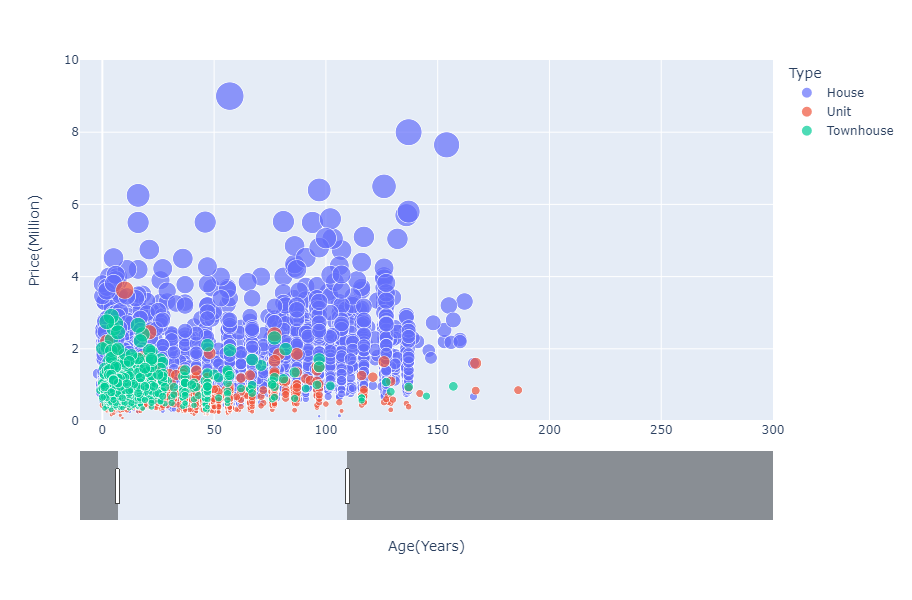

In [59]:
# relationships between property age and selling prices

fig_age = px.scatter(age_price, x='Age(Years)', y='Price(Million)', color='Type',
                     size='Price', hover_data=['Price(Million)','Age(Years)','YearBuilt'],
                     range_x=[-10,300], range_y=[0,10]
                   )
fig_age.update_layout(
                        autosize=False,
                        width=900,
                        height=600,
                    )
fig_age.update_layout(xaxis=dict(
                        rangeslider=dict(visible=True)
                    ),
                     dragmode="zoom"
                     )
                    
fig_age.show()

### Reservoir has the most properties for sale，so I will choose this suburb to analysis

### Analysis Type, Rooms, Bedrooms, Porperty ages, Landsize impact on selling price

In [60]:
df_reservoir = df_melhouse[df_melhouse['Suburb']=='Reservoir']

In [61]:
df_reservoir['Date'] = pd.to_datetime(df_reservoir['Date'])
df_reservoir['Age(Years)']=(df_reservoir['Date'].dt.year)-df_reservoir['YearBuilt']

In [62]:
df_reservoir.head()

,Suburb,Rooms,Type,Price,Date,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Age(Years)
5029,Reservoir,3.0,u,475000.0,2016-03-09,3.0,1.0,1.0,191.0,107.0,1990.0,26.0
5030,Reservoir,2.0,u,415000.0,2016-03-09,2.0,1.0,1.0,189.0,84.0,2012.0,4.0
5031,Reservoir,3.0,h,731000.0,2016-03-12,3.0,1.0,2.0,779.0,138.0,1950.0,66.0
5032,Reservoir,2.0,u,352000.0,2016-03-12,2.0,1.0,1.0,117.0,62.0,2012.0,4.0
5033,Reservoir,3.0,h,723000.0,2016-03-12,3.0,1.0,1.0,535.0,86.0,1950.0,66.0


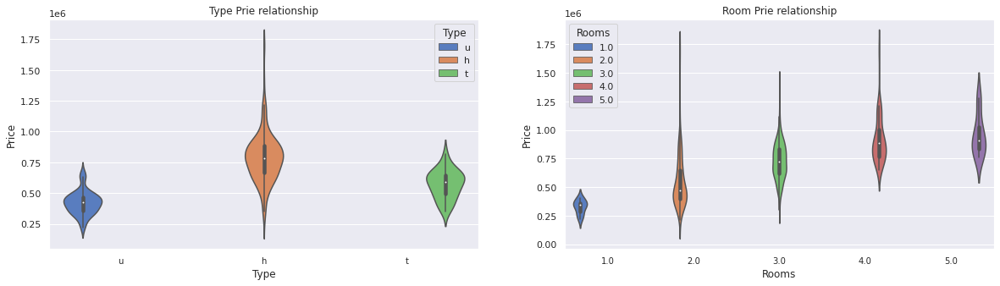

In [63]:
fig, axs = plt.subplots(nrows=1, ncols=2,figsize=(20, 5))
ax0 = axs[0]
ax0.set_xticklabels(df_reservoir['Type'],rotation = 0,fontsize = 'small')
ax0.set_title('Type Prie relationship')
# ax0.get_yaxis().get_major_formatter().set_scientific(False)
ax1 = axs[1]
ax1.set_xticklabels(df_reservoir['Rooms'],rotation = 0,fontsize = 'small')
#ax1.get_yaxis().get_major_formatter().set_scientific(False)
ax1.set_title('Room Prie relationship')

ax_type=sns.violinplot(x=df_reservoir['Type'],y=df_reservoir['Price'],hue=df_reservoir['Type'],palette="muted", ax = ax0)
ax_type=sns.violinplot(x=df_reservoir['Rooms'],y=df_reservoir['Price'],hue=df_reservoir['Rooms'],palette="muted", ax = ax1)


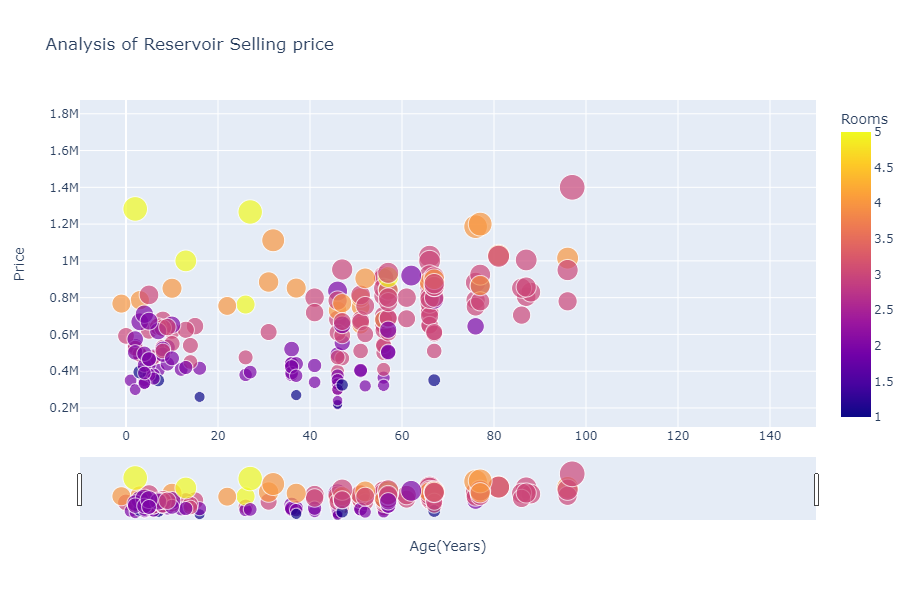

In [64]:
fig_hr = px.scatter(age_price[age_price['Suburb']=='Reservoir'], x='Age(Years)', y='Price', color='Rooms',
                     size='Price', hover_data=['Type','Price','Age(Years)','Rooms','Car','Landsize','YearBuilt'],
                     range_x=[-10,150], title = 'Analysis of Reservoir Selling price'
                   )

fig_hr.update_layout(
                        autosize=False,
                        width=800,
                        height=600,
                    )
fig_hr.update_layout(xaxis=dict(
                        rangeslider=dict(visible=True)
                    ),
                     dragmode="zoom"
                     )
                    
fig_hr.show()

### conclusion: From this analysis, we can see 
 which suburnb has more property for sale, such as Reservoir.
 Each suburb's average price claffified by property type.
 Which part of Melbourne has the high price for sale, south east area.
 The price trend among house, unit and townhouse.
 Price range in each suburb by property type.
 Relationship between property age and price.
 Analysis hottest suburb for type-price and room-price relationship.
 Anaslysis each feature's impact on selling price